In [0]:
# Change directory to VSCode workspace root so that relative path loads work correctly. Turn this addition off with the DataScience.changeDirOnImportExport setting
# ms-python.python added
import os
try:
	os.chdir(os.path.join(os.getcwd(), '..\\..'))
	print(os.getcwd())
except:
	pass


 # Compare Synthetic and Original Taxi Data
 This notebook gives a look at the first version of synthetic
 data generation. This version is designed to be fast and simple.
 Simple because the analyst just pushes one button and the whole
 dataset is synthesized. In other words, we try to create a replica
 of the original dataset.

 This notebook is only looking at descriptive analytics (which,
 by the way, isn't the primary intent of the synthetic data, but
 never-the-less is interesting).

 It is fast (relatively) in that it
 minimizes the number of queries. It does this in two ways. First,
 it doesn't try for too much granularity and it doesn't query
 more than two columns at a time. The intent here is to find out how
 bad the results are as a baseline, and figure out where we need
 to improve.

 Note that this synthetic data only tries to synthesize individual
 rides, and not the behavior of individual drivers over time.

In [1]:
import os
try:
    os.chdir(os.path.join(os.getcwd(), 'notebooks\\taxi'))
    print(os.getcwd())
except:
    pass
from IPython import get_ipython
#Importing libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
# Input data files are available in the "../input/" directory.
import os
import matplotlib.pyplot as plt #visualization
from PIL import  Image
get_ipython().run_line_magic('matplotlib', 'inline')
import pandas as pd
import seaborn as sns #visualization
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
import plotly.offline as py#visualization
py.init_notebook_mode(connected=True)#visualization
import plotly.graph_objs as go#visualization
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import random

c:\Users\francis\Documents\code\python\syn\notebooks\taxi


In [2]:
origPath = "taxi_orig.csv"
orig = pd.read_csv(origPath)
orig = orig.drop(columns=['uid'])
cols = orig.columns.tolist()
cols.sort()
orig = orig[cols]
#orig['dropoff_datetime'] = pd.to_datetime(orig['dropoff_datetime'],unit='s')
#orig['pickup_datetime'] = pd.to_datetime(orig['pickup_datetime'],unit='s')
synPath = "taxi_syn.csv"
syn = pd.read_csv(synPath)
cols = syn.columns.tolist()
cols.sort()
syn = syn[cols]
syn['dropoff_datetime'] = syn['dropoff_datetime'].astype(int)
#syn['dropoff_datetime'] = pd.to_datetime(syn['dropoff_datetime'],unit='s')
syn['pickup_datetime'] = syn['pickup_datetime'].astype(int)
#syn['pickup_datetime'] = pd.to_datetime(syn['pickup_datetime'],unit='s')


 ### Original Taxi Data, first 5 rows

In [3]:
orig.head()

,dropoff_datetime,dropoff_latitude,dropoff_longitude,fare_amount,gender,med,mta_tax,passenger_count,payment_type,pickup_datetime,...,rate_code,sf_flag,surcharge,tip_amount,tolls_amount,total_amount,trip_distance,trip_time_in_secs,vendor_id,zip
0,1.357636e+09,40.768246,-73.861534,32.0,Male,2D839735D8F021DC882EAD1171D45D2B,0.5,1,CRD,1.357634e+09,...,1,N,0.0,6.50,0.0,39.00,11.6,1345,CMT,582337
1,1.357634e+09,40.740086,-74.001244,11.5,Male,2A935F397B9C612D057337170C0F6278,0.5,1,CRD,1.357633e+09,...,1,N,0.0,1.00,0.0,13.00,2.1,832,CMT,3380 ZG
2,1.357636e+09,40.760956,-73.967010,25.0,Male,D5E3EDE8B89E9154A46D14775C8DCBC3,0.5,1,CRD,1.357635e+09,...,1,N,0.0,6.37,0.0,31.87,8.0,1493,CMT,85778
3,1.357646e+09,40.763020,-73.983780,6.0,Male,F38AE6C0CE0DC594E319C528CD2E1081,0.5,2,CRD,1.357646e+09,...,1,N,0.0,1.30,0.0,7.80,0.7,407,CMT,6288 RS
4,1.357634e+09,40.766678,-73.978653,9.5,Female,D87416509B3A2BF0E6E51E00F1A84ECD,0.5,1,CRD,1.357633e+09,...,1,N,0.0,2.00,0.0,12.00,1.8,683,CMT,E3S 5R9


 ### Synthetic Taxi Data, first 5 rows
 Note that the "look-and-feel" of the synthetic matches that of
 the original data pretty well. This is because of an extra step
 we take that looks at each character position of every column
 and tries to mimic the original. For numeric columns, this allows
 us to get approximately the right number of decimal places, and
 for text columns, this allows us to for instance get a decent
 copy of formatted strings (for instance the 'med'column).


In [4]:
syn.head()

,dropoff_datetime,dropoff_latitude,dropoff_longitude,fare_amount,gender,med,mta_tax,passenger_count,payment_type,pickup_datetime,...,rate_code,sf_flag,surcharge,tip_amount,tolls_amount,total_amount,trip_distance,trip_time_in_secs,vendor_id,zip
0,1357642928,40.788265,-73.851837,11.5,Female,7368B29C8B4E78018A3B2D5F11A1051D,0.4,4,CRD,1357642312,...,2,N,0.3,11.45,0.9,11.90,6.56,1407,CMT,57-8
1,1357638700,40.683673,-74.177347,2.5,Female,A542F6EECCBA44625491B1F6C95F4D04,0.1,2,CRD,1357637114,...,5,Y,0.2,6.55,0.6,5.85,1.70,648,CMT,1561
2,1357633104,40.761735,-74.002347,54.5,Female,44279F81E55BC5B04E73AA1EA6ECD382,0.1,1,CRD,1357632020,...,3,N,0.4,1.00,5.5,71.62,16.70,1540,CMT,09917
3,1357646204,40.794490,-73.976429,40.5,Female,FB0E0C48DF8B5331612005F82FCA8F63,0.3,6,CRD,1357645381,...,1,NaN,0.3,4.96,13.1,54.00,15.80,1390,VTS,7875 Z6
4,1357639932,40.743163,-73.916224,15.0,Male,5A7A05E68A448047C1D0F21618247B5C,0.1,1,CRD,1357638313,...,4,NaN,0.4,1.30,0.0,20.60,1.23,1849,VTS,4485


 ## Compare data summaries
 The following compares statistical summaries of the original and synthetic data.
 While the per-column statistics of the synthetic data follow the original data
 pretty closely, the min and max and be far off because Aircloak
 hides extreme values when it anonymizes.
 ### Original data summary

In [5]:
print ("Rows     : " ,orig.shape[0])
orig.describe()

Rows     :  95205


,dropoff_datetime,dropoff_latitude,dropoff_longitude,fare_amount,mta_tax,passenger_count,pickup_datetime,pickup_latitude,pickup_longitude,rate_code,surcharge,tip_amount,tolls_amount,total_amount,trip_distance,trip_time_in_secs
count,9.520500e+04,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000,9.520500e+04,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000,95205.000000
mean,1.357639e+09,40.074775,-72.705130,11.050533,0.499097,1.628748,1.357639e+09,40.096412,-72.766368,1.018696,0.000541,1.247836,0.177843,12.975850,2.362802,716.725225
std,4.166317e+03,5.942817,10.615481,8.255132,0.021233,1.587375,4.156589e+03,5.139851,9.379073,0.200434,0.018254,1.887120,0.955598,10.026532,2.804456,464.018877
min,1.357632e+09,-0.563333,-92.316666,2.500000,0.000000,1.000000,1.357632e+09,0.000000,-74.410751,0.000000,0.000000,0.000000,0.000000,2.500000,0.000000,0.000000
25%,1.357636e+09,40.742111,-73.991623,6.500000,0.500000,1.000000,1.357635e+09,40.741470,-73.991386,1.000000,0.000000,0.000000,0.000000,7.500000,0.950000,386.000000
50%,1.357639e+09,40.755753,-73.980232,9.000000,0.500000,1.000000,1.357638e+09,40.756275,-73.979820,1.000000,0.000000,1.000000,0.000000,10.200000,1.510000,603.000000
75%,1.357643e+09,40.765842,-73.969620,12.500000,0.500000,1.000000,1.357642e+09,40.770382,-73.964149,1.000000,0.000000,2.000000,0.000000,14.500000,2.560000,942.000000
max,1.357651e+09,898.293820,1347.444600,213.000000,0.500000,255.000000,1.357646e+09,50.516666,0.000000,5.000000,1.000000,165.000000,19.750000,238.690000,90.000000,9300.000000


 ### Synthetic data summary

In [6]:
print ("Rows     : " ,syn.shape[0])
syn.describe()

Rows     :  95220


,dropoff_datetime,dropoff_latitude,dropoff_longitude,fare_amount,mta_tax,passenger_count,pickup_datetime,pickup_latitude,pickup_longitude,rate_code,surcharge,tip_amount,tolls_amount,total_amount,trip_distance,trip_time_in_secs
count,9.522000e+04,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000,9.522000e+04,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000,95220.000000
mean,1.357639e+09,40.059064,-72.719327,11.387119,0.250158,1.625593,1.357639e+09,40.084160,-72.752859,2.521540,0.249196,1.168423,7.129858,13.361383,2.513672,730.621487
std,4.178075e+03,5.276490,9.579278,8.261836,0.149973,1.357449,4.175174e+03,5.195024,9.429463,1.170913,0.150031,1.561923,4.187485,10.139478,2.890803,458.019426
min,1.357632e+09,0.000000,-74.179796,2.500000,0.000000,1.000000,1.357632e+09,0.000000,-74.020000,1.000000,0.000000,0.000000,0.000000,3.000000,0.000000,0.000000
25%,1.357636e+09,40.741020,-73.994286,6.500000,0.100000,1.000000,1.357635e+09,40.740980,-73.991735,1.000000,0.100000,0.000000,3.500000,7.500000,1.000000,399.000000
50%,1.357639e+09,40.755510,-73.981633,9.000000,0.300000,1.000000,1.357638e+09,40.758367,-73.979082,3.000000,0.200000,1.000000,7.300000,10.250000,1.600000,635.000000
75%,1.357643e+09,40.766939,-73.969796,13.000000,0.400000,1.000000,1.357642e+09,40.773306,-73.962857,4.000000,0.400000,1.900000,10.800000,15.000000,2.700000,960.000000
max,1.357648e+09,40.900000,0.005000,54.500000,0.500000,6.000000,1.357646e+09,40.848000,0.005000,5.000000,0.500000,15.600000,14.250000,72.900000,19.800000,2940.000000


 ## Compare graphs
 ### Trip Time
 The following graph compares trip time in seconds displayed in
 order of shortest to longest trip. The synthetic data tracks the
 original data very well, with the exception that the synthetic data
 misses a small number of very long trips (over roughly 50 minutes).

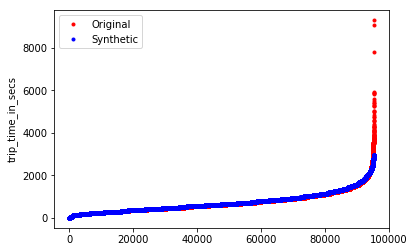

In [7]:
fig=plt.figure()
ax=plt.axes()
col = 'trip_time_in_secs'
yorig = list(orig[col])
yorig.sort()
ysyn = list(syn[col])
ysyn.sort()
ax.plot(range(len(yorig)),yorig,'r.',label='Original')
ax.plot(range(len(ysyn)),ysyn,'b.',label='Synthetic')
plt.ylabel(col)
ax.legend()

 ### Pickup Locations
 From the two graphs below, we can see that the synthetic data
 for pickup location is "in the right ballpark", but leaves a lot
 to be desired. We know from Sebastian's synthetic data as well as
 my earlier stuff published on the CNIL blog that we can do a lot
 better than this.

 There are some strange artifacts in the synthetic data (the
 data points for instance that fall on the longitude -74.00 axis)
 that I need to look into.

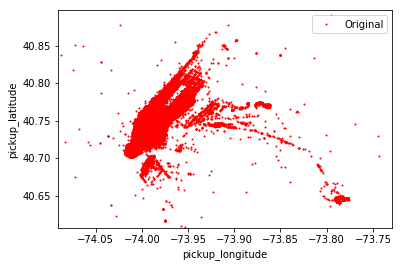

In [8]:
fig=plt.figure()
ax=plt.axes()
xcol = 'pickup_longitude'
ycol = 'pickup_latitude'
yorig = list(orig[ycol])
xorig = list(orig[xcol])
plt.xlim(-74.091,-73.729)
plt.ylim(40.607,40.897)
ax.plot(xorig,yorig,'r.',label='Original',markersize=2)
plt.ylabel(ycol)
plt.xlabel(xcol)
ax.legend()

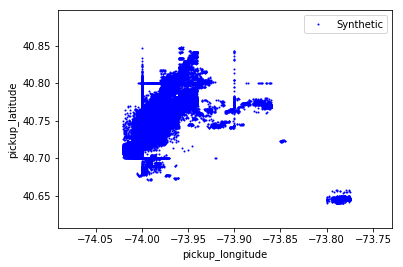

In [9]:
fig=plt.figure()
ax=plt.axes()
xcol = 'pickup_longitude'
ycol = 'pickup_latitude'
ysyn = list(syn[ycol])
xsyn = list(syn[xcol])
plt.xlim(-74.091,-73.729)
plt.ylim(40.607,40.897)
ax.plot(xsyn,ysyn,'b.',label='Synthetic',markersize=2)
plt.ylabel(ycol)
plt.xlabel(xcol)
ax.legend()

 ### Trip time to La Guardia
 The following two graphs show the trip time to La Guardia
 airport for the original and synthetic data. The original
 data shows some reasonable color bands for trip distance.

 The synthetic data here is really unacceptable. The color
 bands are gone. We know we can do better, but I think that the
 analyst would have to specify in advance that they are interested
 in the correlations between location and trip time.

Original data has 1010 rides to La Guardia
Synthetic data has 1046 rides to La Guardia
471 431 128 16
40 277 520 173


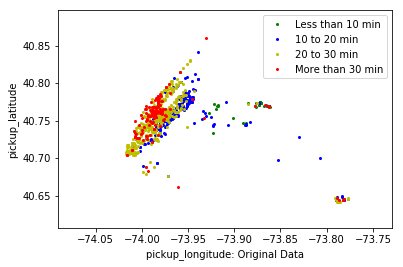

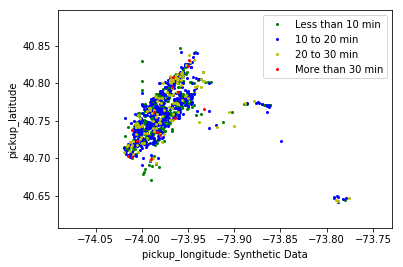

In [10]:
# 40.778259, -73.889729 (upper left)
# 40.764829, -73.853478 (lower right)
# Filter out rides whose dropoff location is around La Guardia
syn_lg = syn[(syn.dropoff_longitude >= -73.8897) &
    (syn.dropoff_longitude <= -73.8535) &
    (syn.dropoff_latitude >= 40.7468) &
    (syn.dropoff_latitude <= 40.7782)]
orig_lg = orig[(orig.dropoff_longitude >= -73.8897) &
    (orig.dropoff_longitude <= -73.8535) &
    (orig.dropoff_latitude >= 40.7468) &
    (orig.dropoff_latitude <= 40.7782)]
print(f"Original data has {len(orig_lg)} rides to La Guardia")
print(f"Synthetic data has {len(syn_lg)} rides to La Guardia")
# Filter out rides by trip time. The following flag determines
# whether we compute this using the trip_time_in_secs column or
# the difference between dropoff and pickup time. Either way,
# the synthetic data is poor here.
if False:
    syn_lg10 = syn_lg[syn.trip_time_in_secs < 600]
    syn_lg20 = syn_lg[(syn.trip_time_in_secs >= 600) &
        (syn.trip_time_in_secs < 1200)]
    syn_lg30 = syn_lg[(syn.trip_time_in_secs >= 1200) &
        (syn.trip_time_in_secs < 1800)]
    syn_lgmore = syn_lg[syn.trip_time_in_secs >= 1800]
    orig_lg10 = orig_lg[orig.trip_time_in_secs < 600]
    orig_lg20 = orig_lg[(orig.trip_time_in_secs >= 600) &
        (orig.trip_time_in_secs < 1200)]
    orig_lg30 = orig_lg[(orig.trip_time_in_secs >= 1200) &
        (orig.trip_time_in_secs < 1800)]
    orig_lgmore = orig_lg[orig.trip_time_in_secs >= 1800]
else:
    syn_lg10 = syn_lg[(syn.dropoff_datetime - syn.pickup_datetime) < 600]
    syn_lg20 = syn_lg[((syn.dropoff_datetime - syn.pickup_datetime) >= 600) &
        ((syn.dropoff_datetime - syn.pickup_datetime) < 1200)]
    syn_lg30 = syn_lg[((syn.dropoff_datetime - syn.pickup_datetime) >= 1200) &
        ((syn.dropoff_datetime - syn.pickup_datetime) < 1800)]
    syn_lgmore = syn_lg[(syn.dropoff_datetime - syn.pickup_datetime) >= 1800]
    orig_lg10 = orig_lg[(orig.dropoff_datetime - orig.pickup_datetime) < 600]
    orig_lg20 = orig_lg[((orig.dropoff_datetime - orig.pickup_datetime) >= 600) &
        ((orig.dropoff_datetime - orig.pickup_datetime) < 1200)]
    orig_lg30 = orig_lg[((orig.dropoff_datetime - orig.pickup_datetime) >= 1200) &
        ((orig.dropoff_datetime - orig.pickup_datetime) < 1800)]
    orig_lgmore = orig_lg[(orig.dropoff_datetime - orig.pickup_datetime) >= 1800]
print(len(syn_lg10), len(syn_lg20), len(syn_lg30), len(syn_lgmore))
print(len(orig_lg10), len(orig_lg20), len(orig_lg30), len(orig_lgmore))
# make graph for original data
fig=plt.figure()
ax=plt.axes()
xcol = 'pickup_longitude'
ycol = 'pickup_latitude'
plt.xlim(-74.091,-73.729)
plt.ylim(40.607,40.897)
yorig_lg10 = list(orig_lg10[ycol])
xorig_lg10 = list(orig_lg10[xcol])
ax.plot(xorig_lg10,yorig_lg10,'go',label='Less than 10 min',markersize=2)
yorig_lg20 = list(orig_lg20[ycol])
xorig_lg20 = list(orig_lg20[xcol])
ax.plot(xorig_lg20,yorig_lg20,'bo',label='10 to 20 min',markersize=2)
yorig_lg30 = list(orig_lg30[ycol])
xorig_lg30 = list(orig_lg30[xcol])
ax.plot(xorig_lg30,yorig_lg30,'yo',label='20 to 30 min',markersize=2)
yorig_lgmore = list(orig_lgmore[ycol])
xorig_lgmore = list(orig_lgmore[xcol])
ax.plot(xorig_lgmore,yorig_lgmore,'ro',label='More than 30 min',markersize=2)
plt.ylabel(ycol)
plt.xlabel(xcol + ': Original Data')
ax.legend()
# make graph for synthetic data
fig=plt.figure()
ax=plt.axes()
xcol = 'pickup_longitude'
ycol = 'pickup_latitude'
plt.xlim(-74.091,-73.729)
plt.ylim(40.607,40.897)
ysyn_lg10 = list(syn_lg10[ycol])
xsyn_lg10 = list(syn_lg10[xcol])
ax.plot(xsyn_lg10,ysyn_lg10,'go',label='Less than 10 min',markersize=2)
ysyn_lg20 = list(syn_lg20[ycol])
xsyn_lg20 = list(syn_lg20[xcol])
ax.plot(xsyn_lg20,ysyn_lg20,'bo',label='10 to 20 min',markersize=2)
ysyn_lg30 = list(syn_lg30[ycol])
xsyn_lg30 = list(syn_lg30[xcol])
ax.plot(xsyn_lg30,ysyn_lg30,'yo',label='20 to 30 min',markersize=2)
ysyn_lgmore = list(syn_lgmore[ycol])
xsyn_lgmore = list(syn_lgmore[xcol])
ax.plot(xsyn_lgmore,ysyn_lgmore,'ro',label='More than 30 min',markersize=2)
plt.ylabel(ycol)
plt.xlabel(xcol + ': Synthetic Data')
ax.legend()

